**Dataset link: https://universe.roboflow.com/seydaoksuzoglu-kjwqn/shoplifting-detection-azlu1/dataset/1#**

In [1]:
!nvidia-smi

Thu Oct 30 06:16:25 2025       
+-----------------------------------------------------------------------------------------+
| NVIDIA-SMI 550.54.15              Driver Version: 550.54.15      CUDA Version: 12.4     |
|-----------------------------------------+------------------------+----------------------+
| GPU  Name                 Persistence-M | Bus-Id          Disp.A | Volatile Uncorr. ECC |
| Fan  Temp   Perf          Pwr:Usage/Cap |           Memory-Usage | GPU-Util  Compute M. |
|                                         |                        |               MIG M. |
|=========================================+========================+======================|
|   0  Tesla T4                       Off |   00000000:00:04.0 Off |                    0 |
| N/A   46C    P8              9W /   70W |       0MiB /  15360MiB |      0%      Default |
|                                         |                        |                  N/A |
+-----------------------------------------+-----

In [2]:
!pip install ultralytics

In [4]:
import ultralytics
ultralytics.checks()

Ultralytics 8.3.222 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
Setup complete ✅ (2 CPUs, 12.7 GB RAM, 39.6/112.6 GB disk)


In [5]:
!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="nJBC3Kr2Z6qyZZJgYERo")
project = rf.workspace("seydaoksuzoglu-kjwqn").project("shoplifting-detection-azlu1")
version = project.version(1)
dataset = version.download("yolov8")


   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 89.9/89.9 kB 9.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 66.8/66.8 kB 7.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 49.9/49.9 MB 23.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.4/1.4 MB 63.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.2/4.2 MB 142.2 MB/s eta 0:00:00
  Attempting uninstall: opencv-python-headless
    Found existing installation: opencv-python-headless 4.12.0.88
    Uninstalling opencv-python-headless-4.12.0.88:
      Successfully uninstalled opencv-python-headless-4.12.0.88
  Attempting uninstall: idna
    Found existing installation: idna 3.11
    Uninstalling idna-3.11:
      Successfully uninstalled idna-3.11


loading Roboflow workspace...
loading Roboflow project...



Extracting Dataset Version Zip to Shoplifting-Detection-1 in yolov8:: 100%|██████████| 1614/1614 [00:00<00:00, 4774.93it/s]


In [6]:
from ultralytics import YOLO

# Load a model
model = YOLO("yolo11n-pose.pt")  # load a pretrained model (recommended for training)

# Train the model
results = model.train(data="/content/Shoplifting-Detection-1/data.yaml", epochs=50, imgsz=640)

Ultralytics 8.3.222 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
engine/trainer: agnostic_nms=False, amp=True, augment=False, auto_augment=randaugment, batch=16, bgr=0.0, box=7.5, cache=False, cfg=None, classes=None, close_mosaic=10, cls=0.5, compile=False, conf=None, copy_paste=0.0, copy_paste_mode=flip, cos_lr=False, cutmix=0.0, data=/content/Shoplifting-Detection-1/data.yaml, degrees=0.0, deterministic=True, device=None, dfl=1.5, dnn=False, dropout=0.0, dynamic=False, embed=None, epochs=50, erasing=0.4, exist_ok=False, fliplr=0.5, flipud=0.0, format=torchscript, fraction=1.0, freeze=None, half=False, hsv_h=0.015, hsv_s=0.7, hsv_v=0.4, imgsz=640, int8=False, iou=0.7, keras=False, kobj=1.0, line_width=None, lr0=0.01, lrf=0.01, mask_ratio=4, max_det=300, mixup=0.0, mode=train, model=yolo11n-pose.pt, momentum=0.937, mosaic=1.0, multi_scale=False, name=train, nbs=64, nms=False, opset=None, optimize=False, optimizer=auto, overlap_mask=True, patience=100, perspective=0.0,

In [8]:
from ultralytics import YOLO

# Load a model
model = YOLO("/content/runs/pose/train/weights/best.pt")  # load a custom model

# Validate the model
metrics = model.val()  # no arguments needed, dataset and settings remembered
metrics.box.map  # map50-95
metrics.box.map50  # map50
metrics.box.map75  # map75
metrics.box.maps  # a list contains map50-95 of each category
metrics.pose.map  # map50-95(P)
metrics.pose.map50  # map50(P)
metrics.pose.map75  # map75(P)
metrics.pose.maps  # a list contains map50-95(P) of each category

Ultralytics 8.3.222 🚀 Python-3.12.12 torch-2.8.0+cu126 CUDA:0 (Tesla T4, 15095MiB)
YOLO11n-pose summary (fused): 109 layers, 2,785,771 parameters, 0 gradients, 7.1 GFLOPs
val: Fast image access ✅ (ping: 0.0±0.0 ms, read: 1617.6±492.1 MB/s, size: 61.2 KB)
val: Scanning /content/Shoplifting-Detection-1/valid/labels.cache... 66 images, 1 backgrounds, 0 corrupt: 100% ━━━━━━━━━━━━ 66/66 122.8Kit/s 0.0s
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95)     Pose(P          R      mAP50  mAP50-95): 100% ━━━━━━━━━━━━ 5/5 1.4it/s 3.5s
                   all         66         75      0.817       0.81      0.872      0.706      0.138      0.141     0.0679     0.0145
                normal         23         29      0.785      0.759      0.794      0.626          0          0          0          0
           shoplifting         45         46       0.85      0.862      0.949      0.786      0.275      0.283      0.136     0.0289
Speed: 8.5ms preprocess, 7.2ms 

array([          0,     0.02894])

In [9]:
from ultralytics import YOLO

# Load a model
model = YOLO("/content/runs/pose/train/weights/best.pt")  # load a custom model

# Predict with the model
results = model("/content/Shoplifting-Detection-1/test/images")  # predict on an image

# Access the results
for result in results:
    xy = result.keypoints.xy  # x and y coordinates
    xyn = result.keypoints.xyn  # normalized
    kpts = result.keypoints.data  # x, y, visibility (if available)


image 1/33 /content/Shoplifting-Detection-1/test/images/240_F_609924516_poMt3jOfYkGomqdFkDN2MROjZBz9vIsc_jpg.rf.daf7a218a3c642bb1f33dfe227f7854b.jpg: 640x640 1 shoplifting, 11.4ms
image 2/33 /content/Shoplifting-Detection-1/test/images/5_mp4-0000_jpg.rf.6497052662b7f05324ecc655ff32c8a8.jpg: 640x640 1 shoplifting, 9.4ms
image 3/33 /content/Shoplifting-Detection-1/test/images/85308338_11_jpg.rf.437ca3422964e61dc0ed1e195c368c75.jpg: 640x640 1 shoplifting, 8.9ms
image 4/33 /content/Shoplifting-Detection-1/test/images/Furti-in-negozio_-tutta-l-oscenita-del-furto-in-15-secondi-_out0028_jpg.rf.a97e1368aa684f716dc9145782780d00.jpg: 640x640 1 shoplifting, 8.8ms
image 5/33 /content/Shoplifting-Detection-1/test/images/Shoplifting010_x264_30_mp4-0_jpg.rf.8aa12866cd29cf1105ae34ca607a78e8.jpg: 640x640 (no detections), 15.4ms
image 6/33 /content/Shoplifting-Detection-1/test/images/Shoplifting021_x264_24_mp4-0_jpg.rf.82156aeef0da52d108ec00a8635a39e9.jpg: 640x640 (no detections), 16.0ms
image 7/33 /co

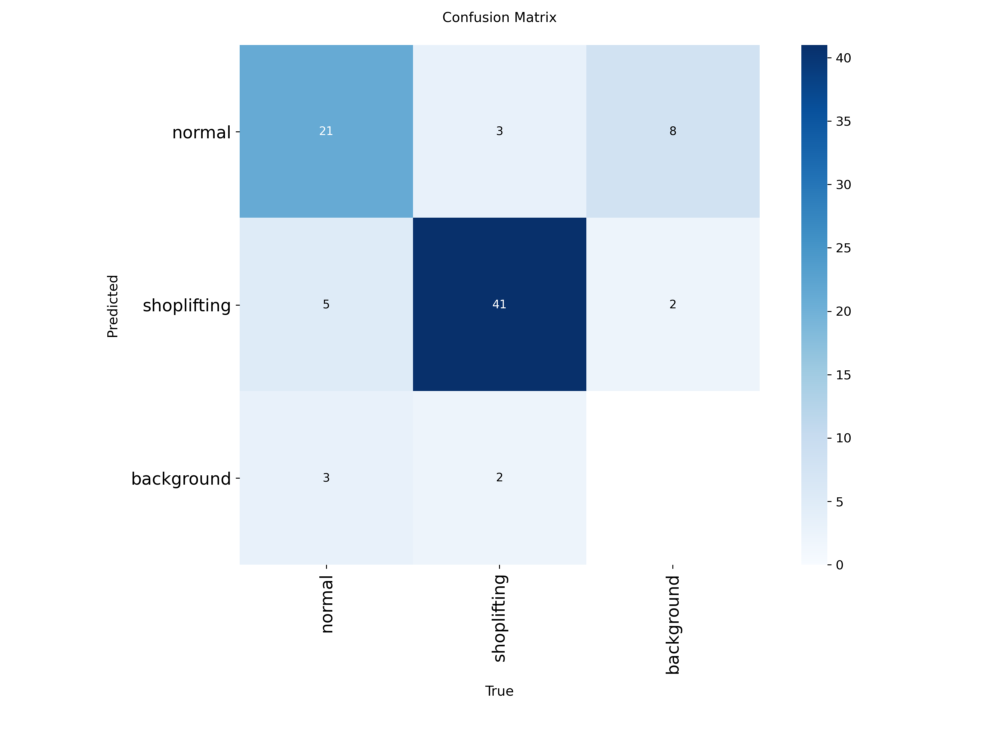

In [17]:
from IPython.display import Image

Image("/content/runs/pose/train/confusion_matrix.png",width=700)

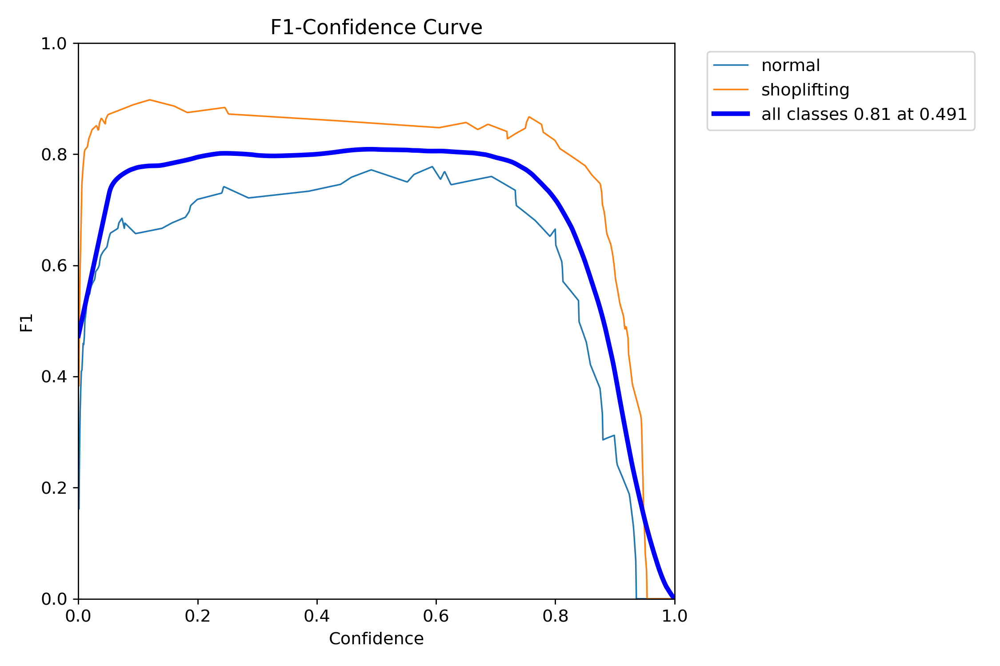

In [18]:
Image("/content/runs/pose/train/BoxF1_curve.png",width=700)

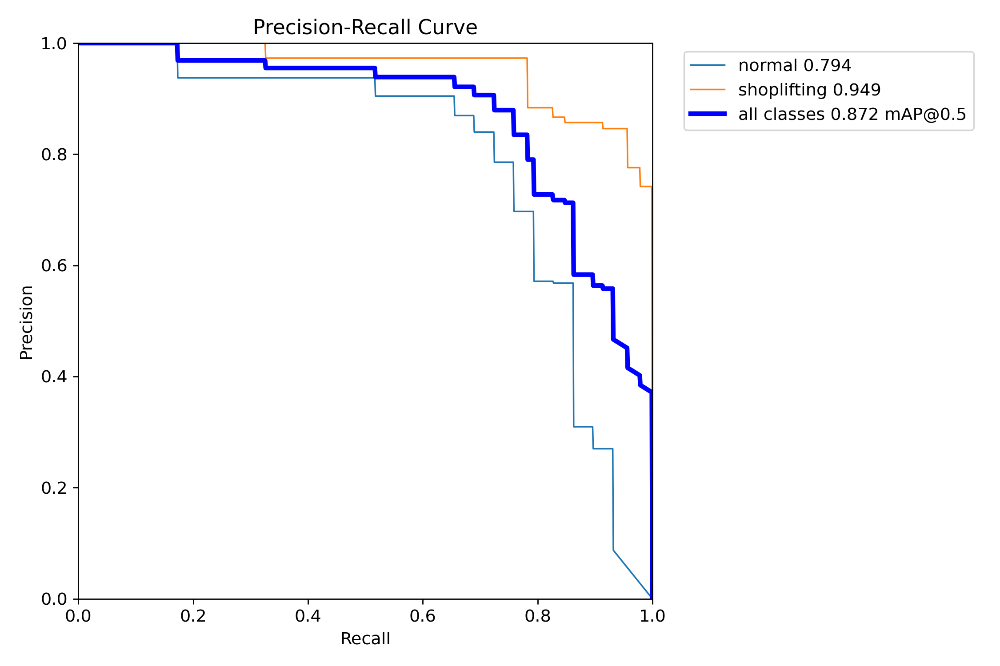

In [19]:
Image("/content/runs/pose/train/BoxPR_curve.png",width=700)

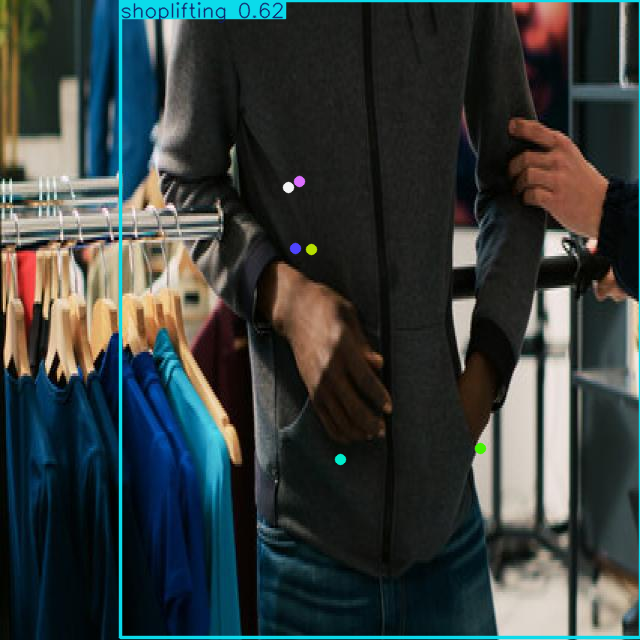

None


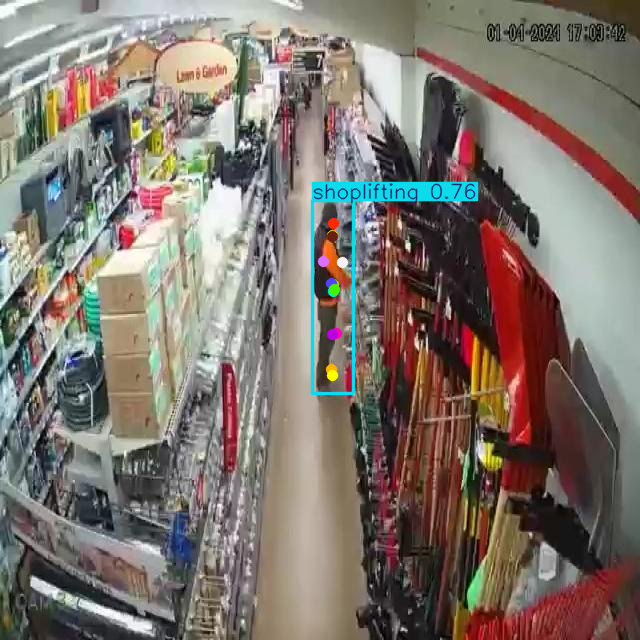

None


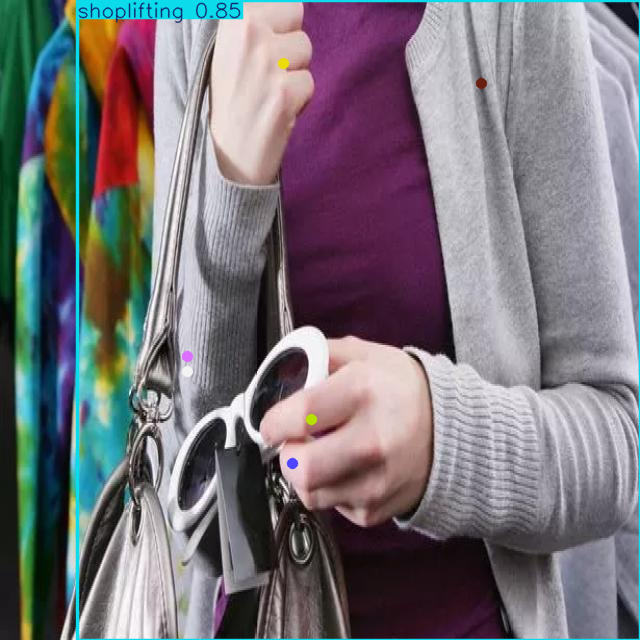

None


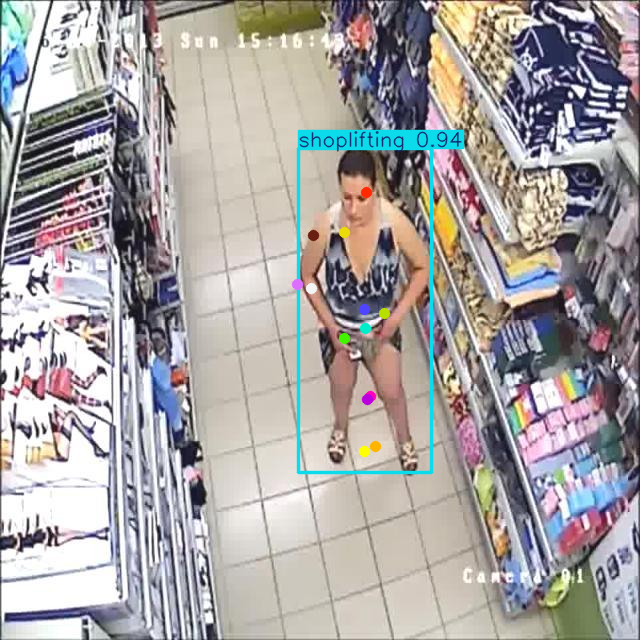

None


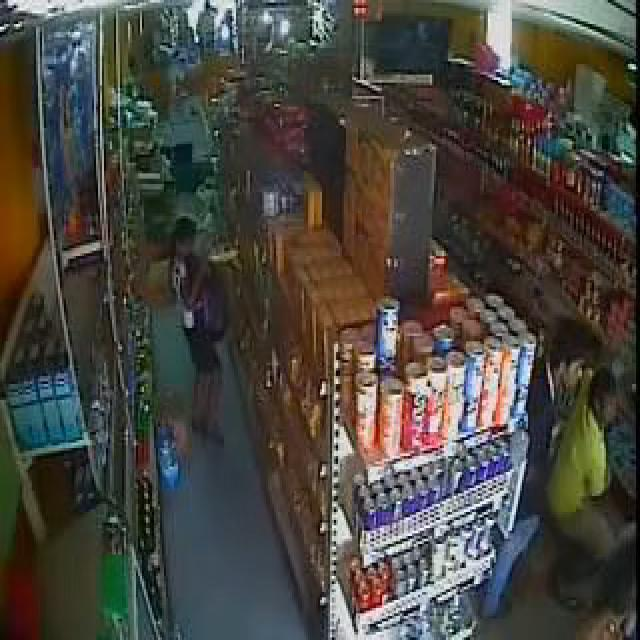

None


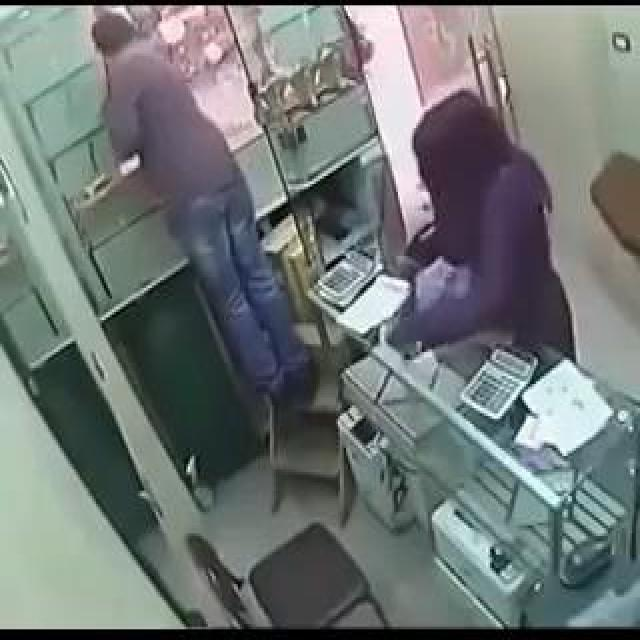

None


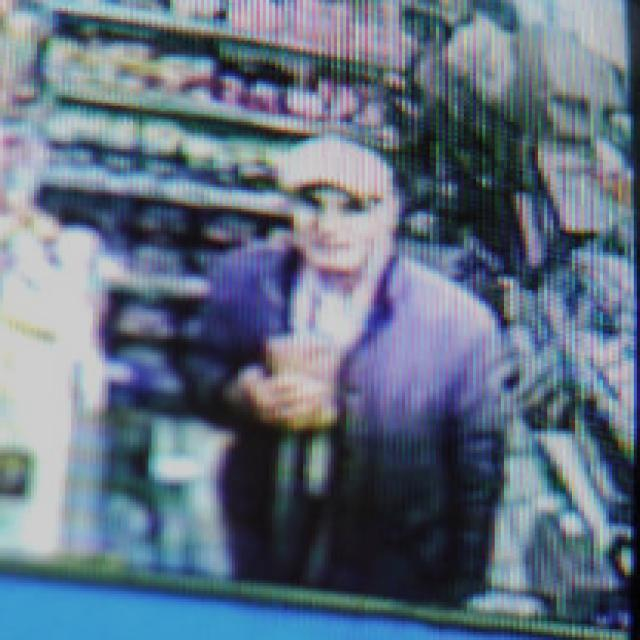

None


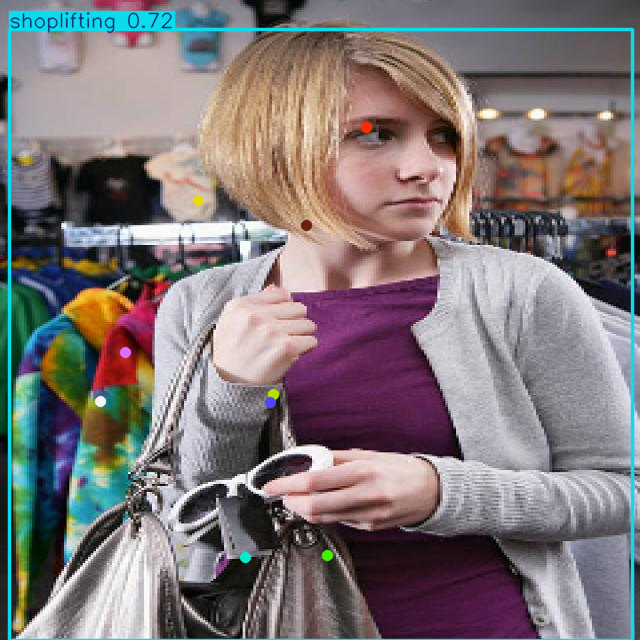

None


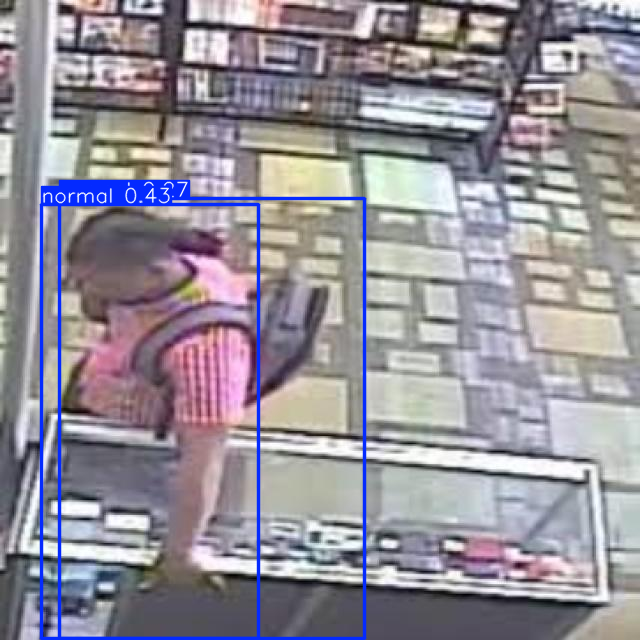

None


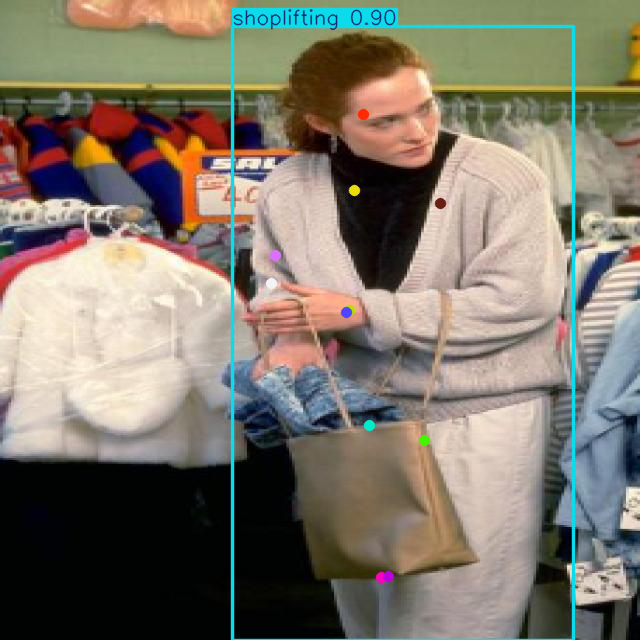

None


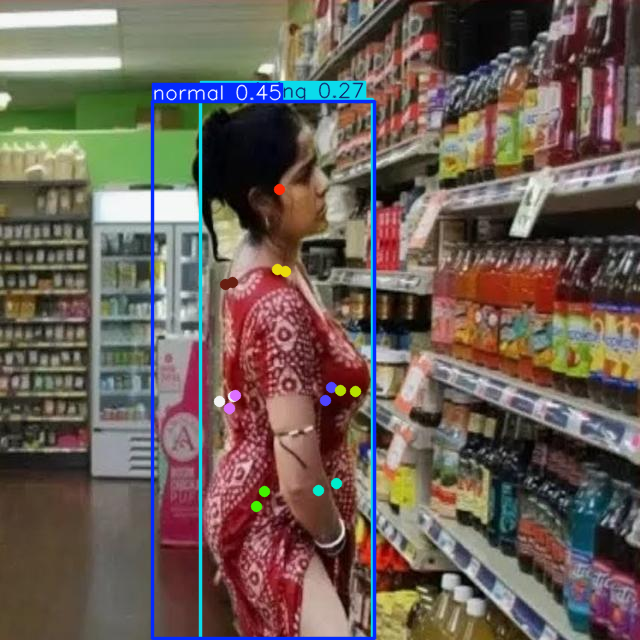

None


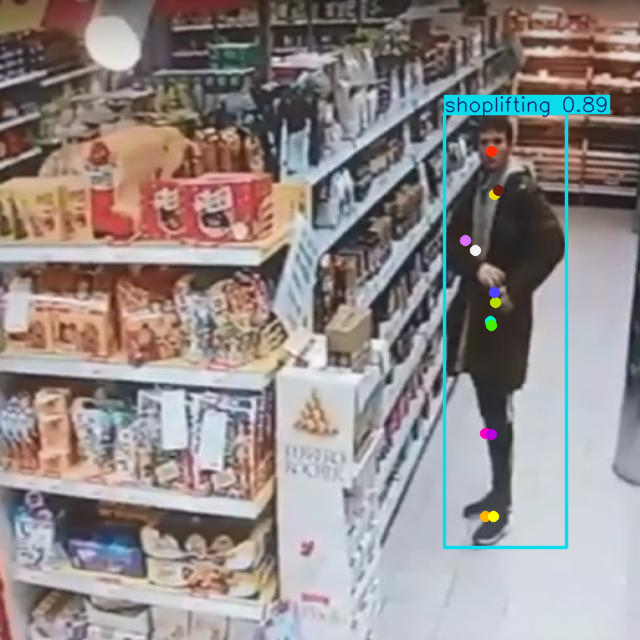

None


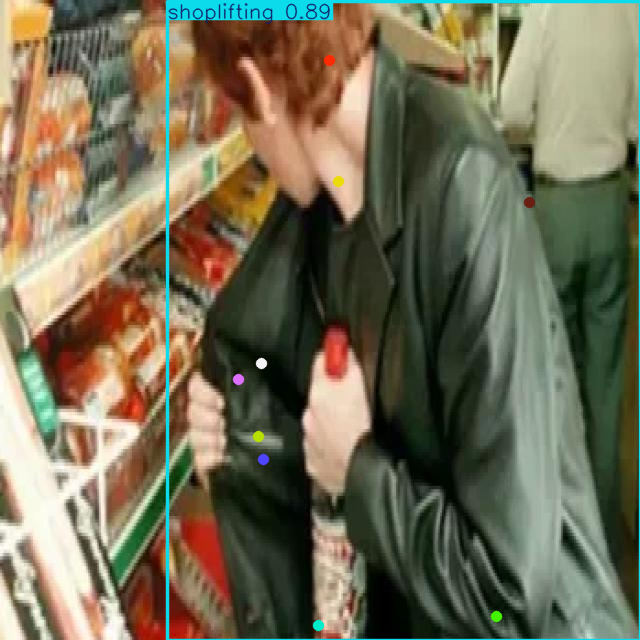

None


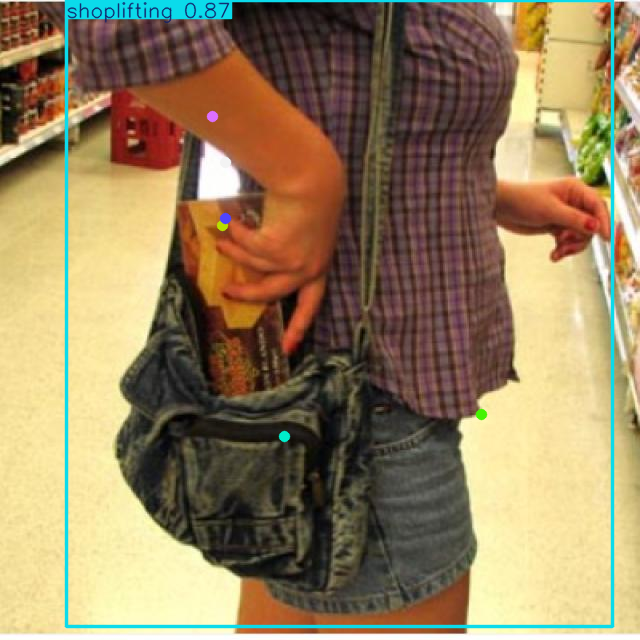

None


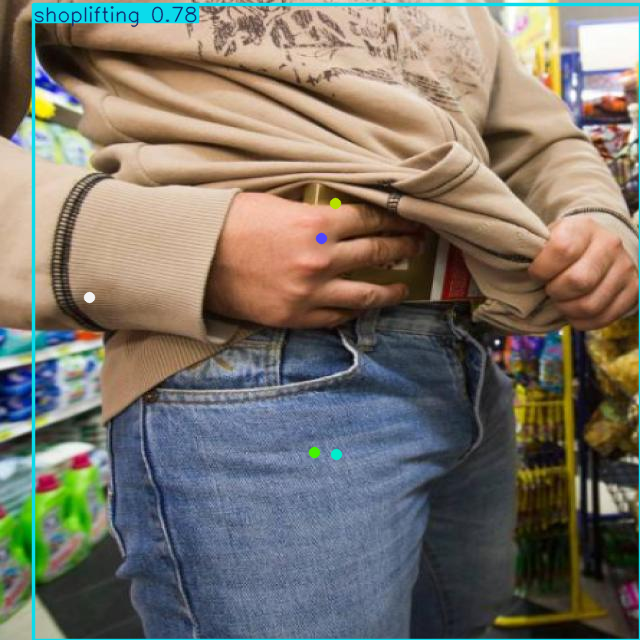

None


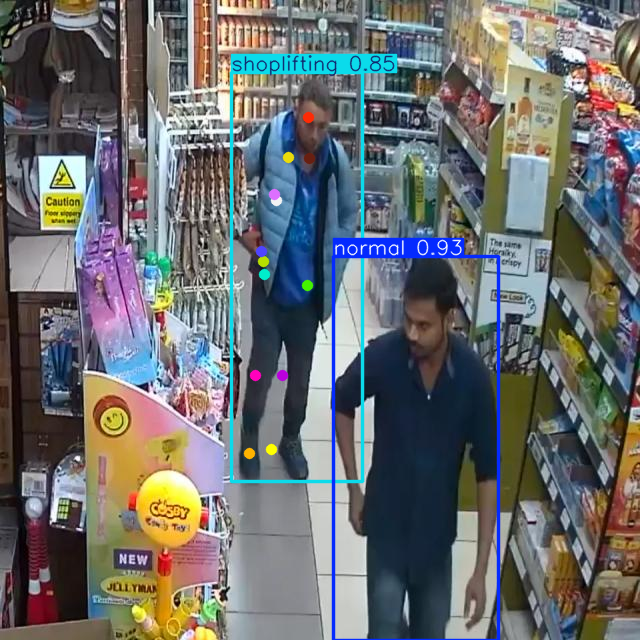

None


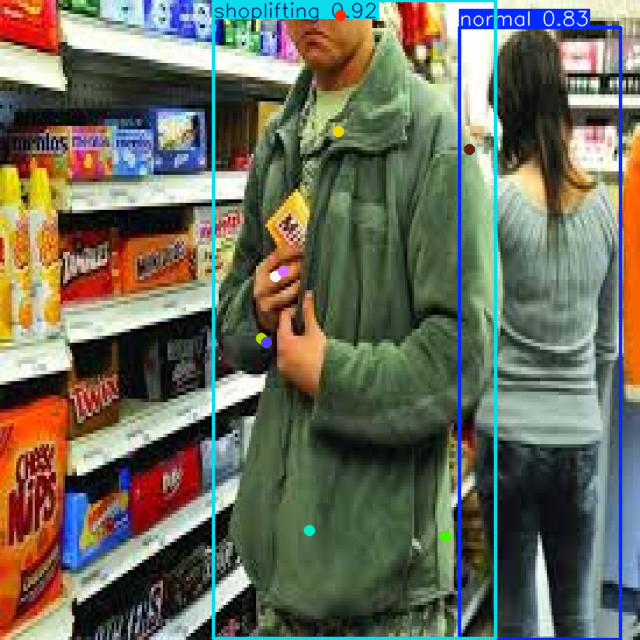

None


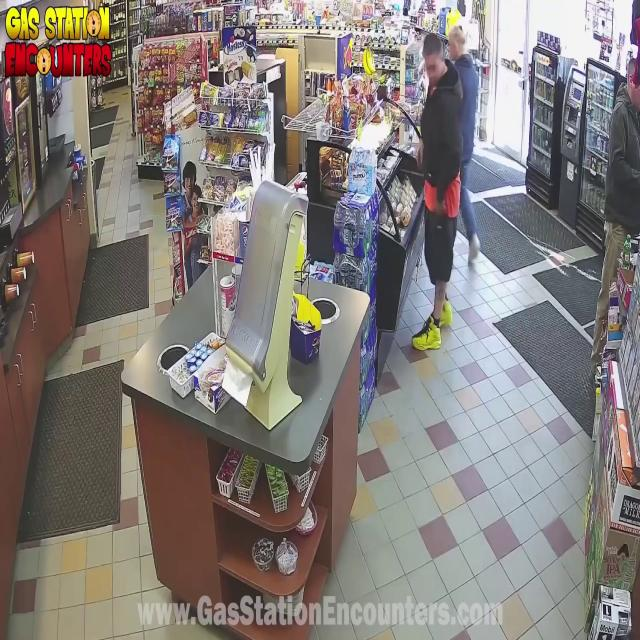

None


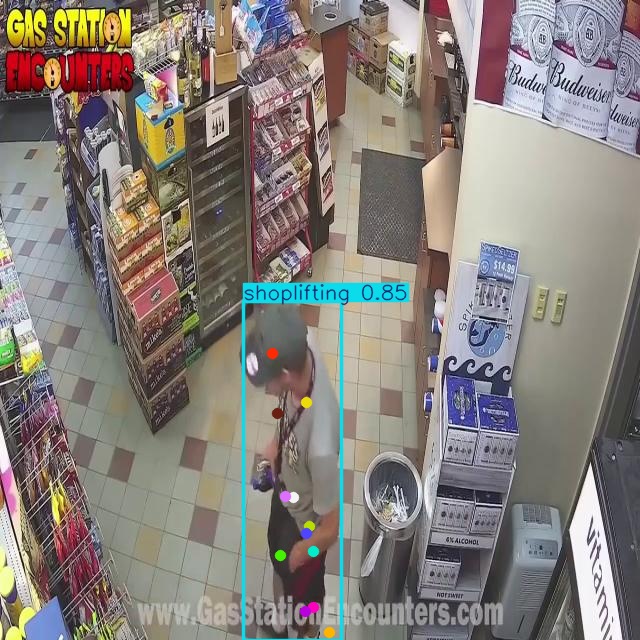

None


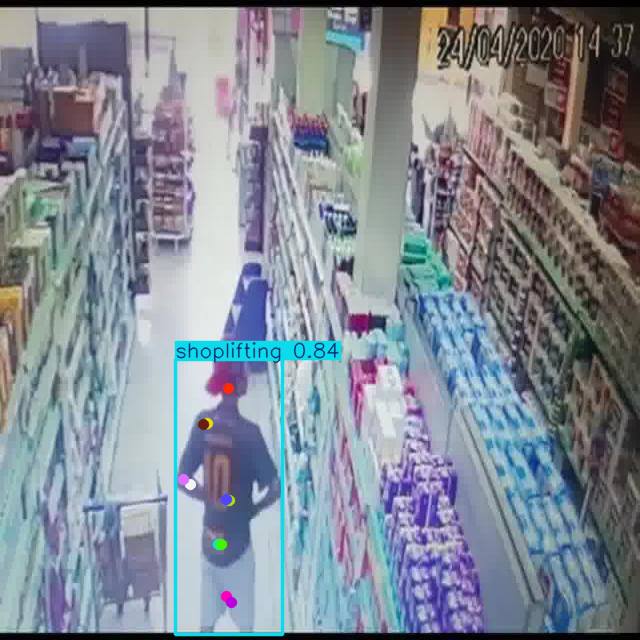

None


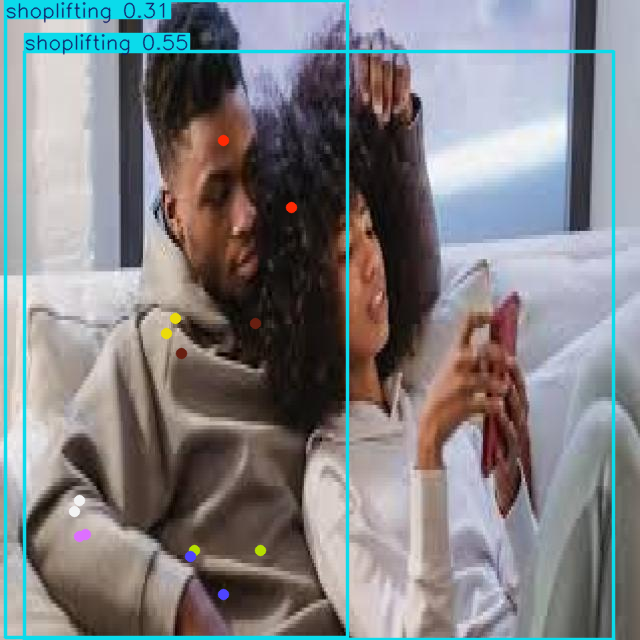

None


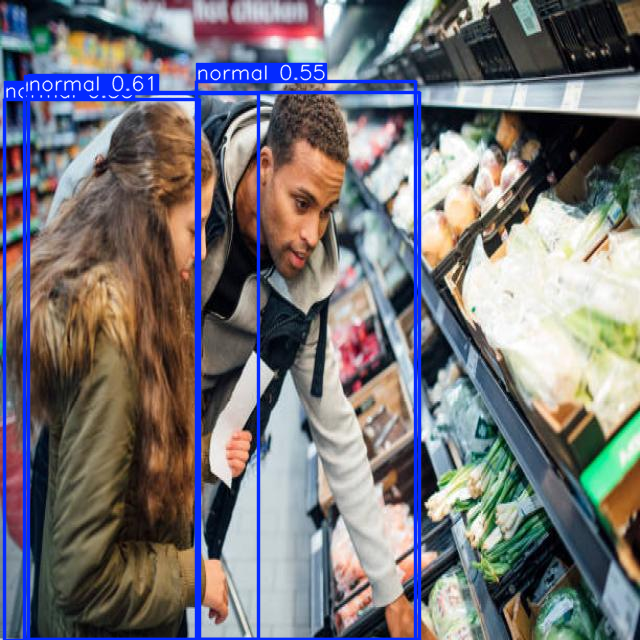

None


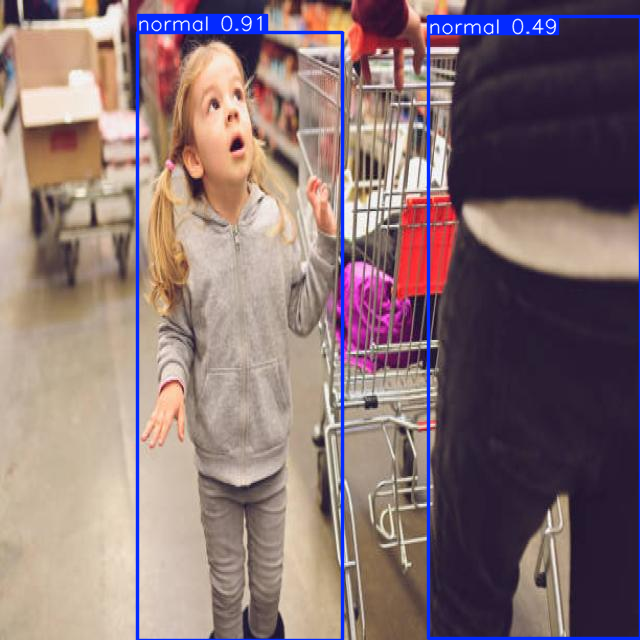

None


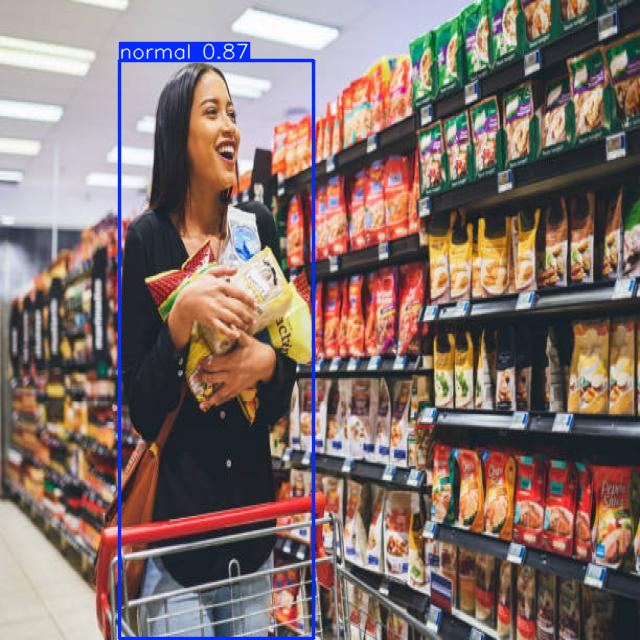

None


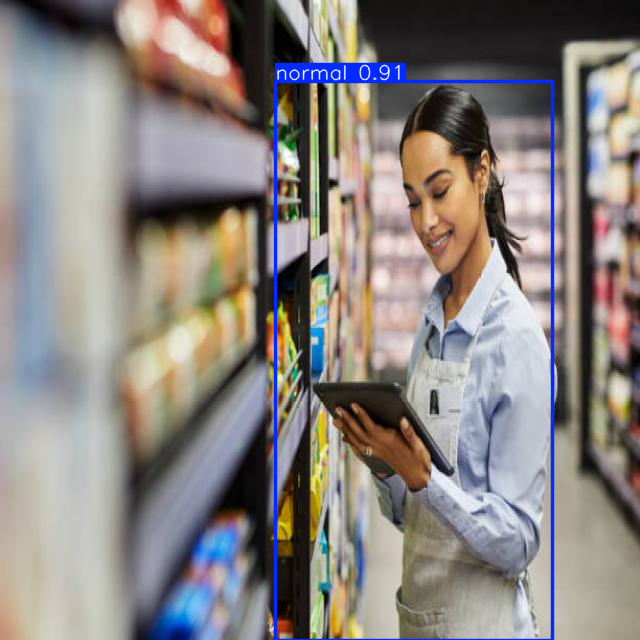

None


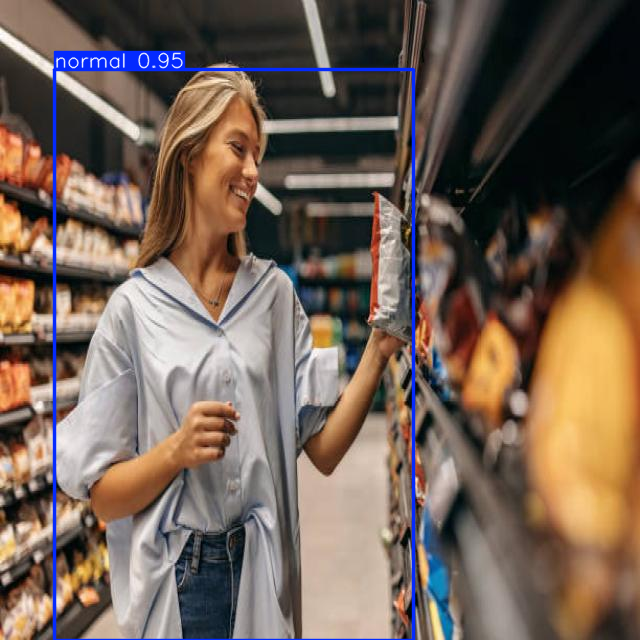

None


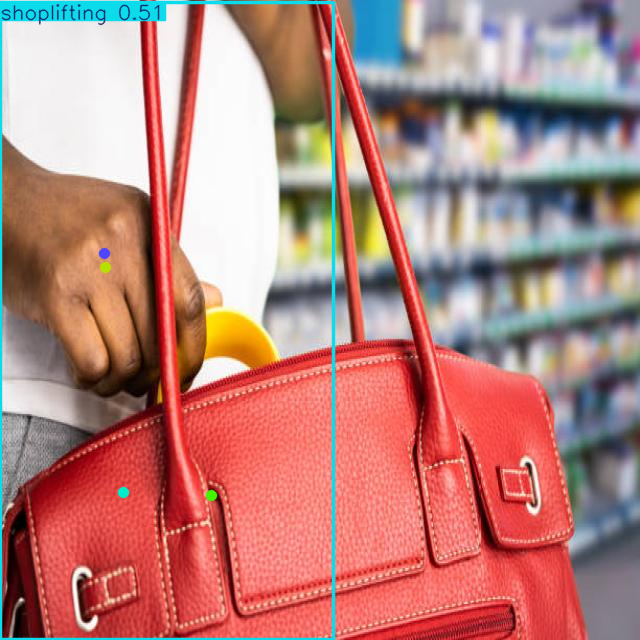

None


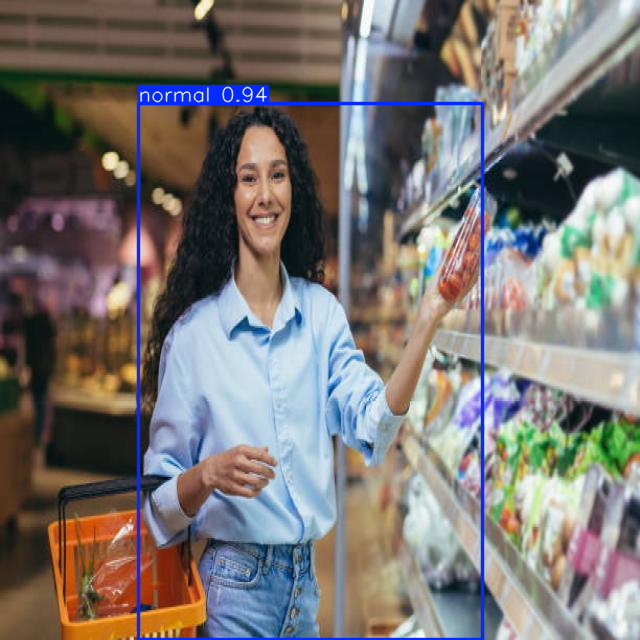

None


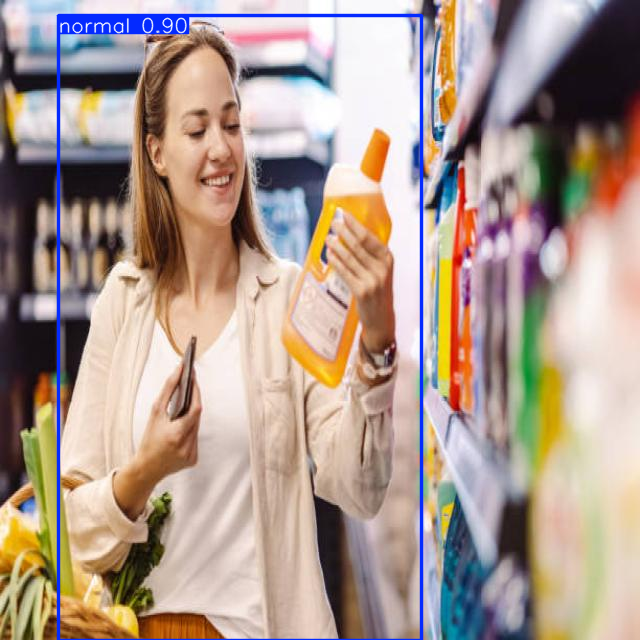

None


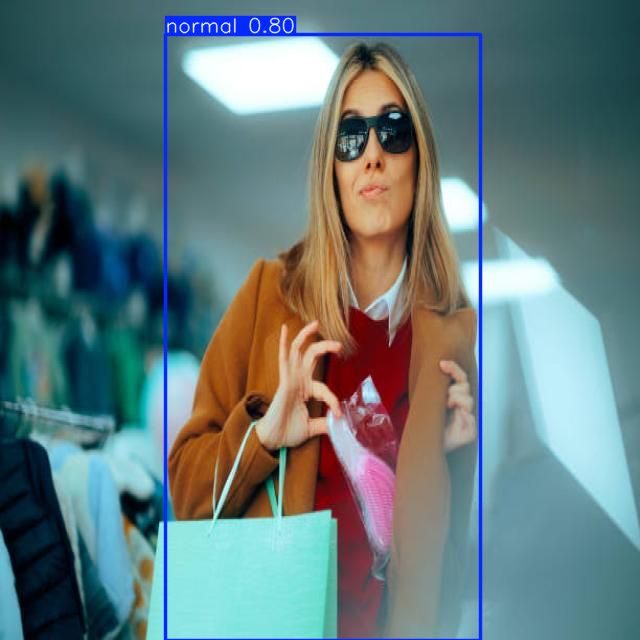

None


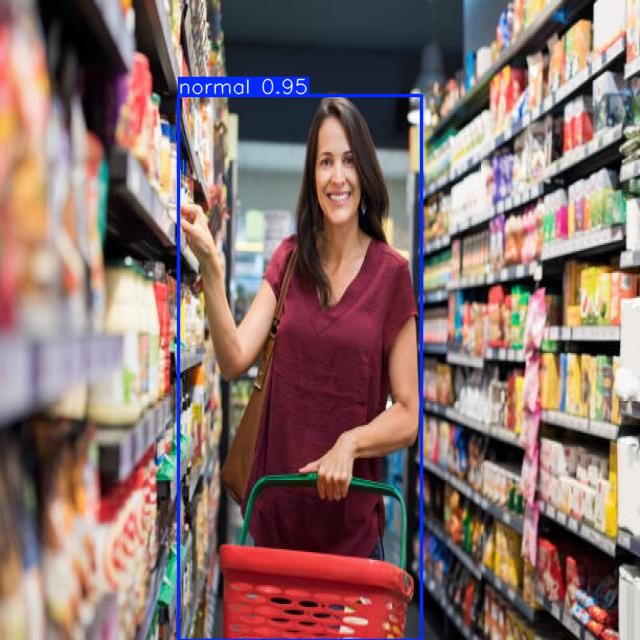

None


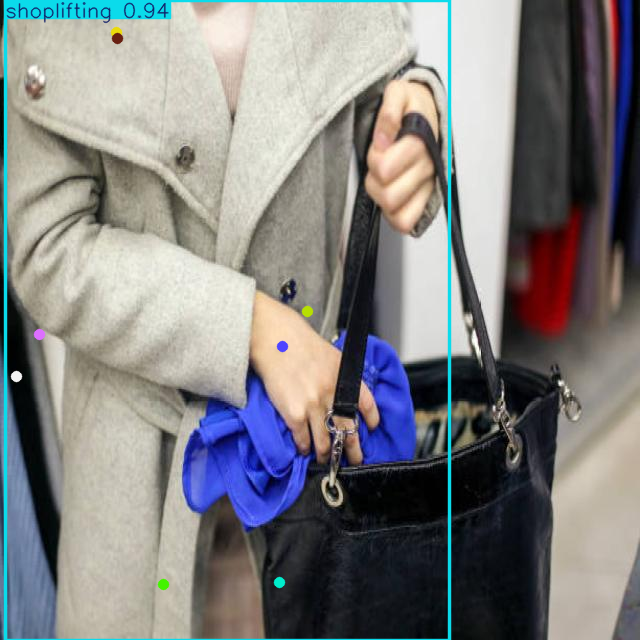

None


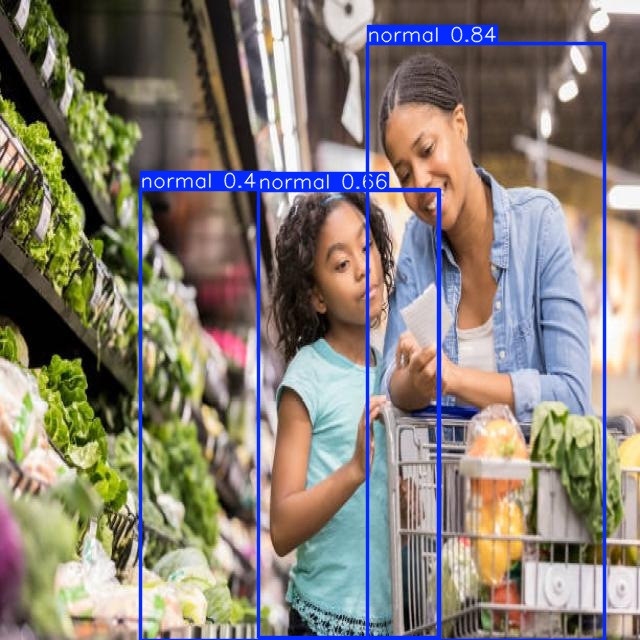

None


In [20]:
# View results
for r in results:
    print(r.show())  # print the Keypoints object containing the detected keypoints

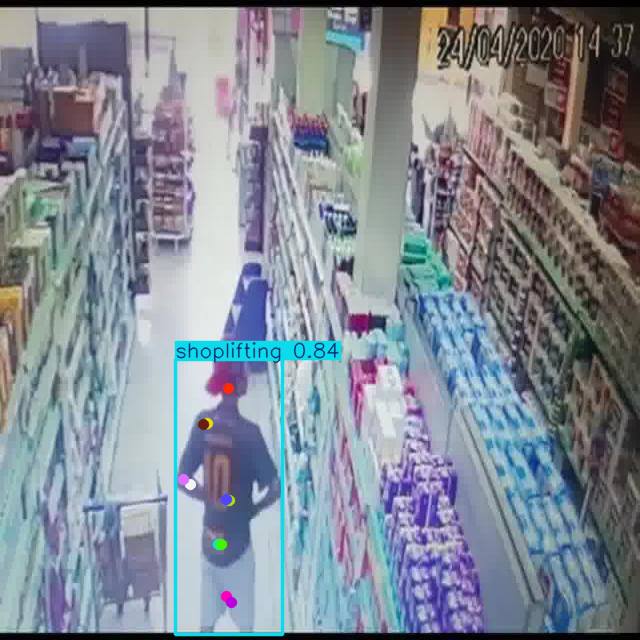

In [25]:
results[19].show()


image 1/1 /content/shoplifting.jpeg: 640x640 (no detections), 13.3ms
Speed: 2.3ms preprocess, 13.3ms inference, 0.8ms postprocess per image at shape (1, 3, 640, 640)


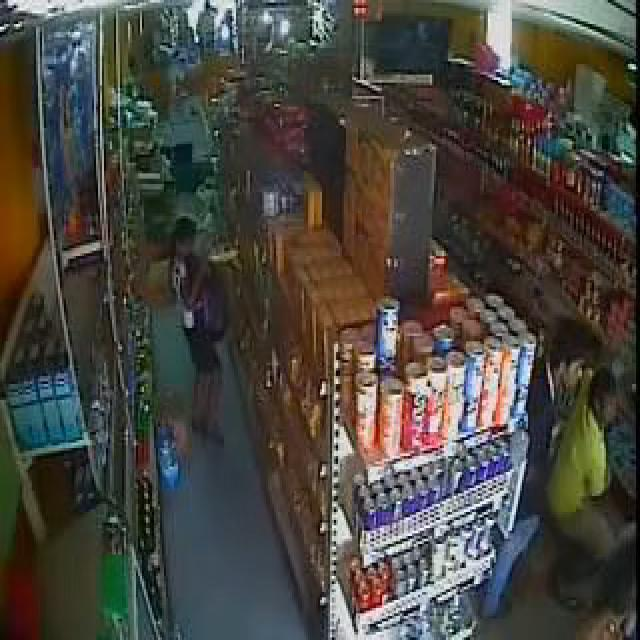

In [27]:
# Predict with the model
result = model("/content/shoplifting.jpeg")  # predict on an image
result[0].show()